In [1]:
%pylab inline

import scipy
import scipy.signal
import scipy.io.wavfile

import numpy as np
import pygraphviz as pgv
from IPython.display import Image
from cycler import cycler
import numba
from numba import jit

def draw(dot):
    return Image(pgv.AGraph(dot).draw(format='png', prog='dot'))

Populating the interactive namespace from numpy and matplotlib


# M17 Demodulator

<a rel="license" href="http://creativecommons.org/licenses/by-sa/4.0/"><img alt="Creative Commons License" style="border-width:0" src="https://i.creativecommons.org/l/by-sa/4.0/88x31.png" /></a><br />This work is licensed under a <a rel="license" href="http://creativecommons.org/licenses/by-sa/4.0/">Creative Commons Attribution-ShareAlike 4.0 International License</a>.

Please attribute the work to *Rob Riggs, WX9O, Mobilinkd LLC*.

This notebook contains the lab notes on implementing an M17 baseband
demodulator.  There are a few key components of this, and more complex
implementations, ones that are designed to handle more than just voice
communication, may have many more components.

The key pieces are:

 1. The baseband demodulator.
 1. The framer.
 2. The link setup frame decoder.
 3. The audio frame decoder.

Just as we did with the modulator, we are going to keep the sample rate
an integer multiple of the data rate.  This simplifies a lot of the
calculations which is necessary since the goal is to eventually port this
implementation to a microcontroller.

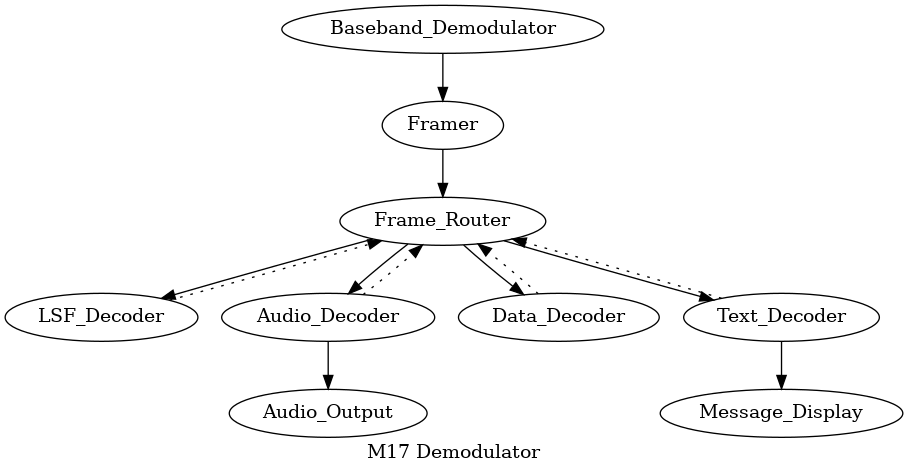

In [2]:
g1 = """digraph top {
   label = "M17 Demodulator";
   
   Baseband_Demodulator -> Framer;
   Framer -> Frame_Router;
   Frame_Router -> LSF_Decoder
   LSF_Decoder -> Frame_Router [style=dotted];
   Frame_Router -> Audio_Decoder
   Audio_Decoder -> Frame_Router [style=dotted];
   Audio_Decoder -> Audio_Output
   Frame_Router -> Data_Decoder
   Data_Decoder -> Frame_Router [style=dotted];
   Frame_Router -> Text_Decoder
   Text_Decoder -> Message_Display
   Text_Decoder -> Frame_Router [style=dotted];
}"""

draw(g1)

We will ignore the Data Decoder and Text Decoder portions and focus
solely on the *link setup frame* decoder and audio decoder.  The
return channel from decoder to router is needed for A) routing and
B) end of stream.  The LSF contains information about the contents
of the stream to follow.  And the stream handlers need to inform the
router when the last frame has been received, or if it is receiving
frames that it cannot handle.

And conceptually the frame router and decoders are separate things.
But we may implement them as one object as it simplifies the state
machine when just dealing with audio.

In [3]:
def plot_to_notebook(samples, sample_rate, legend = ['4-FSK signal'], lines = ['-'], props = None):
    
    duration = len(samples) / sample_rate
    t = np.linspace(0, duration, len(samples), endpoint=True)
    plt.figure()
    plt.rcParams['figure.figsize'] = [12, 4]
    ax = plt.subplot(1, 1, 1)
    if props is not None: ax.set_prop_cycle(props)
    plt.xlabel('Time (msec)')
    plt.locator_params(axis='y', nbins=8)
    plt.grid()
    plt.ylim(-4,4)
    plt.xticks(np.arange(0, duration, 1.0/4800.0), rotation=45)
    try:
        if len(samples[0]) > 1:
            lines = lines * len(samples[0])
            for i in range(len(samples[0])):
                plt.plot(t, [x[i] for i in samples], lines[i])
        else:
            plt.plot(t, samples, lines[0])
    except:
        plt.plot(t, samples, lines[0])

    plt.legend(legend)

## Test Data Generation

Before we begin, we will need some test data.  Since we completed the
modulator before beginning on the demodulator, we have a valid (or so
we hoped) output stream.

*During the develoment of the demodulator, a number of problems with the
modulator were fixed.  One of the problems with Python and notebooks is
that there is a global namespace, and it is easy to mistake using a
global variable instead of a member variable by forgetting the `self.`
prefix.*

We are going to start by reading the output of the modulator, a single channel,
16-bit WAV file at 48ksps.  This will be prepended with a short burst of random
noise, plus a bit of AWGN.  This is our received baseband signal.  The noisy
signal will have an SNR of about 6dB.

https://stackoverflow.com/questions/52913749/add-random-noise-with-specific-snr-to-a-signal

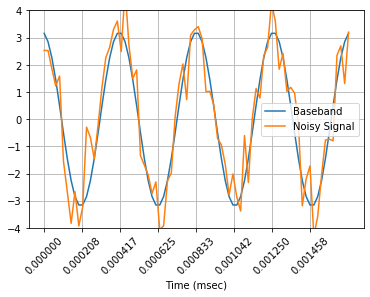

In [4]:
sample_rate, modulated_data = scipy.io.wavfile.read("m17-4fsk.wav")
symbol_rate = 4800
samples_per_symbol = int(sample_rate / symbol_rate)

SNR_dB = 6.0
snr = 10.0**(SNR_dB/10.0)
power = modulated_data.var()
noise = np.sqrt(power / snr) * scipy.randn(len(modulated_data))
noisy = modulated_data + noise

random = (np.random.rand(17171) - 0.5) * 30
baseband_data = np.concatenate([random, noisy])

index = 100

plot_to_notebook(
    [x for x in zip(modulated_data[index:index+80],noisy[index:index+80])],
    sample_rate, ['Baseband', 'Noisy Signal'])

# 4-FSK Demodulator

We are going to start with the 4-FSK demodulator first.  This is
reponsible for decoding the baseband signal into symbols that can
be assembled into frames.

The eventual goal of this demodulator is to be ported to run on
a rather weak embedded processor.  Computational cost is an important
consideration in the design.

I first started by looking at [APCO 25 4-FSK Demodulator](https://www.qsl.net/k/kb9mwr//projects/dv/apco25/GnuradioFourLevelFSK.pdf)
and then directly at the C code for [gr-fsk4](https://github.com/JohandeGraaf/gr-fsk4).
I ported the C code to Python and included it below.  I chose not to
use the gr-fsk4 code because it required that the deviation be known
to within about 20% and I wanted a demodulator that could be used for
diagnostic and instrumentation purposes where the expected deviation
might not be known.

I also ran into an issue where the gr-fsk4 demodulator would make
timing errors, returning +1/-1 symbols for the preamble instead of
+3/-3.  This would happen if the sampling rate was such that some
preamble samples were close enough to a valid +1/-1 range. This
caused the clock phase to remain incorrect throughout the entire
preamble.  The demodulator would then stumble when the first sync
word arrived.

The demodulator discussed below is able to demodulate 4-FSK signals
with a much greater deviation and frequency error.  Larger deviation
errors just result in clock recovery taking more time. And it is not
possible for it to lock to an invalid clock phase in the same manner
as gr-fsk4.

The secret to the demodulator is that we oversample enough to be able
to measure the tangent of the current sample point with enough accuracy
to drive the symbol sampler to the proper 0 phase.

With 10 samples per symbol, we are able to measure this accurately
enough to achieve reasonable performance. And since the tangent is a
very simple measurement, it is a ratio of measured quantities, its
computational cost is trivial.  Another key is that large errors
in phase are magnified by the nature of of the $tan$ function which
results in quick convergence with very low gain.

## 4-FSK Demodulator Diagram

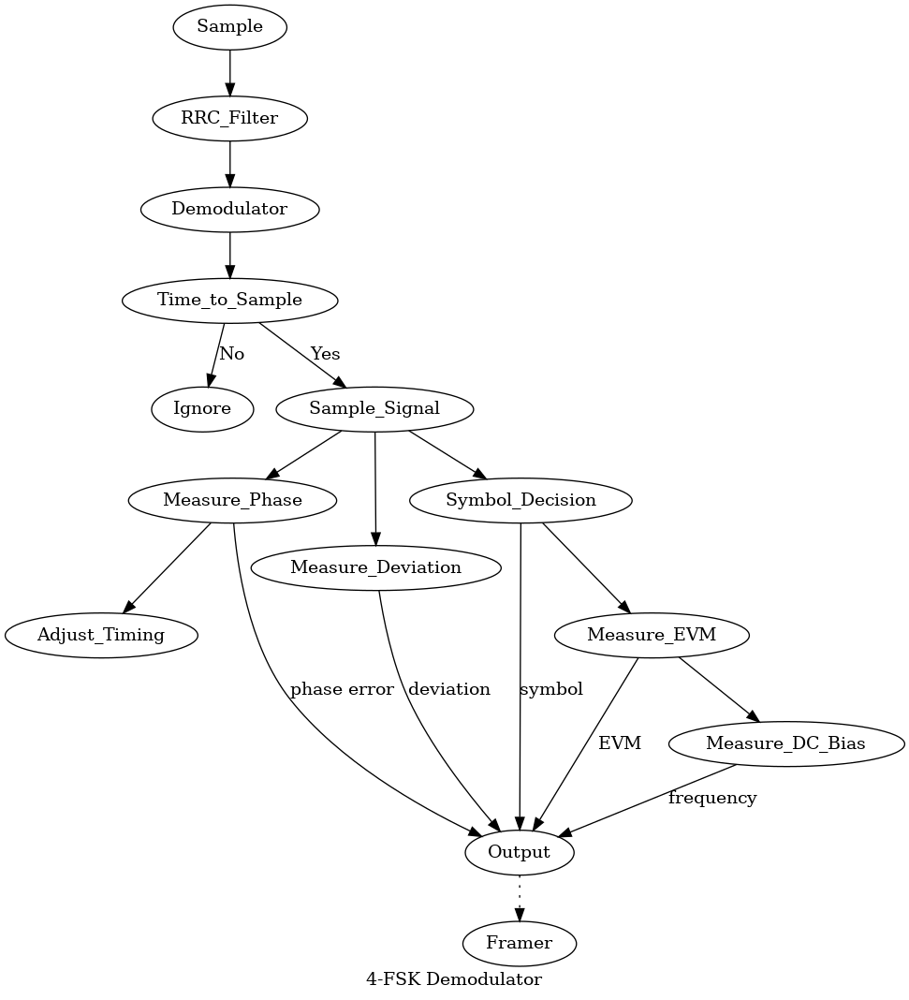

In [50]:
g2 = """digraph top {
   label = "4-FSK Demodulator";
   
   Sample -> RRC_Filter;
   RRC_Filter -> Demodulator;
   Demodulator -> Time_to_Sample;
   Time_to_Sample -> Ignore [label="No"];
   Time_to_Sample -> Sample_Signal [label="Yes"];
   Sample_Signal -> Measure_Phase;
   Measure_Phase -> Adjust_Timing;
   Sample_Signal -> Measure_Deviation;
   Sample_Signal -> Symbol_Decision -> Measure_EVM -> Measure_DC_Bias;
   Symbol_Decision -> Output [label="symbol"];
   Measure_EVM -> Output [label="EVM"];
   Measure_Phase -> Output [label="phase error"];
   Measure_Deviation -> Output [label="deviation"];
   Measure_DC_Bias -> Output [label="frequency"];
   Output -> Framer [style=dotted];
}"""

draw(g2)

## RRC Filter

The first part of the demodulator is to filter the incoming samples
with a root raised cosine filter.  This is a matched filter which is
identical to the filter applied in the modulator.

This typically belongs directly in the modulator, but we are going
to do the filtering here, on the entire baseband signal at once.

In our embedded systems, these are applied to blocks of data as they
arrive from the ADC.  And we typically use reasonably large DMA buffers
spanning 10-20 symbols.

### Commpy RRC Filter Bug

There is a bug in the scikit-commpy library which results in erroneous
filter coefficients when using an even number of filter taps.

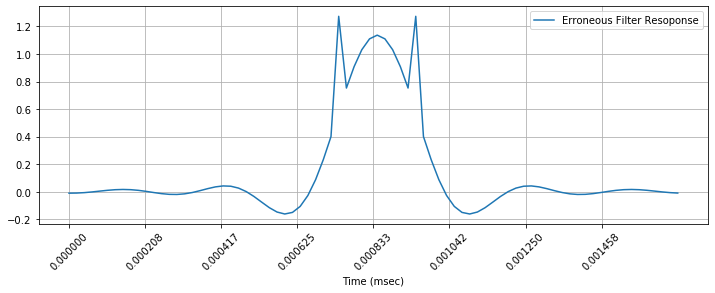

In [6]:
from scipy.signal import lfiltic, lfilter
from commpy.filters import rrcosfilter

pos, taps = rrcosfilter(int(samples_per_symbol * 8), 0.5, 1.0/symbol_rate, sample_rate)

def response_plot(taps, sample_rate, legend):

    duration = len(taps) / sample_rate
    t = np.linspace(0, duration, len(taps), endpoint=True)
    plt.figure()
    plt.rcParams['figure.figsize'] = [12, 4]
    ax = plt.subplot(1, 1, 1)
    plt.xlabel('Time (msec)')
    plt.locator_params(axis='y', nbins=8)
    plt.grid()
    plt.xticks(np.arange(0, duration, 1.0/4800.0), rotation=45)
    plt.plot(t, taps)
    plt.legend(legend)
    
response_plot(taps, sample_rate, ["Erroneous Filter Resoponse"])

### Correct Filter Response

Below are the taps we will use and the expected filter response.

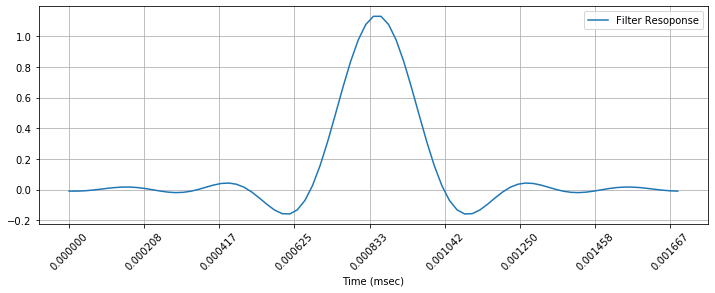

In [7]:
pos, taps = rrcosfilter(int(samples_per_symbol * 8 + 1), 0.5, 1.0/symbol_rate, sample_rate)

response_plot(taps, sample_rate, ["Filter Resoponse"])

### Filter Baseband Data

We will now apply the filter to the baseband signal.  Recall that
this signal has an SNR of about 6dB, with visible noise superimposed
on the signal.

Note that we are using the scipy.signal filter functions here because
this is essentially what we plan to do in the embedded implementation.
It allows us to stream data into a filter.  Because in this case we are
filtering an entire dataset, we could just use `np.convolve()` here.

The filter provides about 8x gain which we remove here.

We show the noisy signal superimposed with the newly filtered signal.

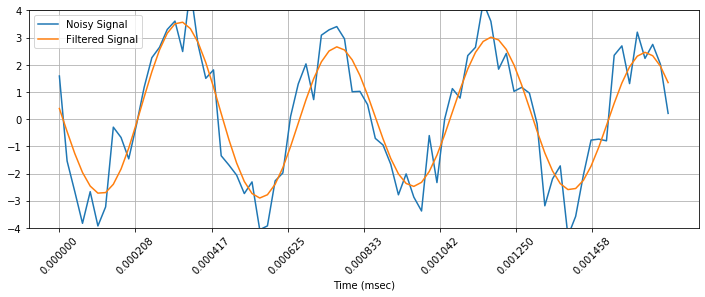

In [8]:
delay = len(taps) // 2
zl = lfiltic(taps, 1.0, [], [])
filtered_data, zl = lfilter(taps, 1.0, np.concatenate([baseband_data, np.zeros(delay)]), -1, zl)
filtered_data *= 0.125

index = 17275
tmp = [x for x in zip(baseband_data[index:index+80], filtered_data[index+delay:index+delay+80])]
plot_to_notebook(tmp, sample_rate, ['Noisy Signal', 'Filtered Signal'])

## gr_fsk4 Demodulator

Below is the basic implementation of the [gr-fsk4](https://github.com/JohandeGraaf/gr-fsk4)
demodulator ported to Python.  This is here for posterity.  Issues
described above prevent it from being used for our demodulator.

In [9]:
from scipy.signal import butter, sosfilt, sosfilt_zi
import random

class FSK4Demod(object):
    """This code is a direct port of https://github.com/JohandeGraaf/gr-fsk4
    This code is explicitly licensed GPL.
    """
    
    NTAPS = 8
    NSTEPS = 128
    
    # MMSE interpolation filter matrix
    taps = [
      #    -4            -3            -2            -1             0             1             2             3                mu
      [  0.00000e+00,  0.00000e+00,  0.00000e+00,  0.00000e+00,  1.00000e+00,  0.00000e+00,  0.00000e+00,  0.00000e+00 ], #   0/128
      [ -1.54700e-04,  8.53777e-04, -2.76968e-03,  7.89295e-03,  9.98534e-01, -5.41054e-03,  1.24642e-03, -1.98993e-04 ], #   1/128
      [ -3.09412e-04,  1.70888e-03, -5.55134e-03,  1.58840e-02,  9.96891e-01, -1.07209e-02,  2.47942e-03, -3.96391e-04 ], #   2/128
      [ -4.64053e-04,  2.56486e-03, -8.34364e-03,  2.39714e-02,  9.95074e-01, -1.59305e-02,  3.69852e-03, -5.92100e-04 ], #   3/128
      [ -6.18544e-04,  3.42130e-03, -1.11453e-02,  3.21531e-02,  9.93082e-01, -2.10389e-02,  4.90322e-03, -7.86031e-04 ], #   4/128
      [ -7.72802e-04,  4.27773e-03, -1.39548e-02,  4.04274e-02,  9.90917e-01, -2.60456e-02,  6.09305e-03, -9.78093e-04 ], #   5/128
      [ -9.26747e-04,  5.13372e-03, -1.67710e-02,  4.87921e-02,  9.88580e-01, -3.09503e-02,  7.26755e-03, -1.16820e-03 ], #   6/128
      [ -1.08030e-03,  5.98883e-03, -1.95925e-02,  5.72454e-02,  9.86071e-01, -3.57525e-02,  8.42626e-03, -1.35627e-03 ], #   7/128
      [ -1.23337e-03,  6.84261e-03, -2.24178e-02,  6.57852e-02,  9.83392e-01, -4.04519e-02,  9.56876e-03, -1.54221e-03 ], #   8/128
      [ -1.38589e-03,  7.69462e-03, -2.52457e-02,  7.44095e-02,  9.80543e-01, -4.50483e-02,  1.06946e-02, -1.72594e-03 ], #   9/128
      [ -1.53777e-03,  8.54441e-03, -2.80746e-02,  8.31162e-02,  9.77526e-01, -4.95412e-02,  1.18034e-02, -1.90738e-03 ], #  10/128
      [ -1.68894e-03,  9.39154e-03, -3.09033e-02,  9.19033e-02,  9.74342e-01, -5.39305e-02,  1.28947e-02, -2.08645e-03 ], #  11/128
      [ -1.83931e-03,  1.02356e-02, -3.37303e-02,  1.00769e-01,  9.70992e-01, -5.82159e-02,  1.39681e-02, -2.26307e-03 ], #  12/128
      [ -1.98880e-03,  1.10760e-02, -3.65541e-02,  1.09710e-01,  9.67477e-01, -6.23972e-02,  1.50233e-02, -2.43718e-03 ], #  13/128
      [ -2.13733e-03,  1.19125e-02, -3.93735e-02,  1.18725e-01,  9.63798e-01, -6.64743e-02,  1.60599e-02, -2.60868e-03 ], #  14/128
      [ -2.28483e-03,  1.27445e-02, -4.21869e-02,  1.27812e-01,  9.59958e-01, -7.04471e-02,  1.70776e-02, -2.77751e-03 ], #  15/128
      [ -2.43121e-03,  1.35716e-02, -4.49929e-02,  1.36968e-01,  9.55956e-01, -7.43154e-02,  1.80759e-02, -2.94361e-03 ], #  16/128
      [ -2.57640e-03,  1.43934e-02, -4.77900e-02,  1.46192e-01,  9.51795e-01, -7.80792e-02,  1.90545e-02, -3.10689e-03 ], #  17/128
      [ -2.72032e-03,  1.52095e-02, -5.05770e-02,  1.55480e-01,  9.47477e-01, -8.17385e-02,  2.00132e-02, -3.26730e-03 ], #  18/128
      [ -2.86289e-03,  1.60193e-02, -5.33522e-02,  1.64831e-01,  9.43001e-01, -8.52933e-02,  2.09516e-02, -3.42477e-03 ], #  19/128
      [ -3.00403e-03,  1.68225e-02, -5.61142e-02,  1.74242e-01,  9.38371e-01, -8.87435e-02,  2.18695e-02, -3.57923e-03 ], #  20/128
      [ -3.14367e-03,  1.76185e-02, -5.88617e-02,  1.83711e-01,  9.33586e-01, -9.20893e-02,  2.27664e-02, -3.73062e-03 ], #  21/128
      [ -3.28174e-03,  1.84071e-02, -6.15931e-02,  1.93236e-01,  9.28650e-01, -9.53307e-02,  2.36423e-02, -3.87888e-03 ], #  22/128
      [ -3.41815e-03,  1.91877e-02, -6.43069e-02,  2.02814e-01,  9.23564e-01, -9.84679e-02,  2.44967e-02, -4.02397e-03 ], #  23/128
      [ -3.55283e-03,  1.99599e-02, -6.70018e-02,  2.12443e-01,  9.18329e-01, -1.01501e-01,  2.53295e-02, -4.16581e-03 ], #  24/128
      [ -3.68570e-03,  2.07233e-02, -6.96762e-02,  2.22120e-01,  9.12947e-01, -1.04430e-01,  2.61404e-02, -4.30435e-03 ], #  25/128
      [ -3.81671e-03,  2.14774e-02, -7.23286e-02,  2.31843e-01,  9.07420e-01, -1.07256e-01,  2.69293e-02, -4.43955e-03 ], #  26/128
      [ -3.94576e-03,  2.22218e-02, -7.49577e-02,  2.41609e-01,  9.01749e-01, -1.09978e-01,  2.76957e-02, -4.57135e-03 ], #  27/128
      [ -4.07279e-03,  2.29562e-02, -7.75620e-02,  2.51417e-01,  8.95936e-01, -1.12597e-01,  2.84397e-02, -4.69970e-03 ], #  28/128
      [ -4.19774e-03,  2.36801e-02, -8.01399e-02,  2.61263e-01,  8.89984e-01, -1.15113e-01,  2.91609e-02, -4.82456e-03 ], #  29/128
      [ -4.32052e-03,  2.43930e-02, -8.26900e-02,  2.71144e-01,  8.83893e-01, -1.17526e-01,  2.98593e-02, -4.94589e-03 ], #  30/128
      [ -4.44107e-03,  2.50946e-02, -8.52109e-02,  2.81060e-01,  8.77666e-01, -1.19837e-01,  3.05345e-02, -5.06363e-03 ], #  31/128
      [ -4.55932e-03,  2.57844e-02, -8.77011e-02,  2.91006e-01,  8.71305e-01, -1.22047e-01,  3.11866e-02, -5.17776e-03 ], #  32/128
      [ -4.67520e-03,  2.64621e-02, -9.01591e-02,  3.00980e-01,  8.64812e-01, -1.24154e-01,  3.18153e-02, -5.28823e-03 ], #  33/128
      [ -4.78866e-03,  2.71272e-02, -9.25834e-02,  3.10980e-01,  8.58189e-01, -1.26161e-01,  3.24205e-02, -5.39500e-03 ], #  34/128
      [ -4.89961e-03,  2.77794e-02, -9.49727e-02,  3.21004e-01,  8.51437e-01, -1.28068e-01,  3.30021e-02, -5.49804e-03 ], #  35/128
      [ -5.00800e-03,  2.84182e-02, -9.73254e-02,  3.31048e-01,  8.44559e-01, -1.29874e-01,  3.35600e-02, -5.59731e-03 ], #  36/128
      [ -5.11376e-03,  2.90433e-02, -9.96402e-02,  3.41109e-01,  8.37557e-01, -1.31581e-01,  3.40940e-02, -5.69280e-03 ], #  37/128
      [ -5.21683e-03,  2.96543e-02, -1.01915e-01,  3.51186e-01,  8.30432e-01, -1.33189e-01,  3.46042e-02, -5.78446e-03 ], #  38/128
      [ -5.31716e-03,  3.02507e-02, -1.04150e-01,  3.61276e-01,  8.23188e-01, -1.34699e-01,  3.50903e-02, -5.87227e-03 ], #  39/128
      [ -5.41467e-03,  3.08323e-02, -1.06342e-01,  3.71376e-01,  8.15826e-01, -1.36111e-01,  3.55525e-02, -5.95620e-03 ], #  40/128
      [ -5.50931e-03,  3.13987e-02, -1.08490e-01,  3.81484e-01,  8.08348e-01, -1.37426e-01,  3.59905e-02, -6.03624e-03 ], #  41/128
      [ -5.60103e-03,  3.19495e-02, -1.10593e-01,  3.91596e-01,  8.00757e-01, -1.38644e-01,  3.64044e-02, -6.11236e-03 ], #  42/128
      [ -5.68976e-03,  3.24843e-02, -1.12650e-01,  4.01710e-01,  7.93055e-01, -1.39767e-01,  3.67941e-02, -6.18454e-03 ], #  43/128
      [ -5.77544e-03,  3.30027e-02, -1.14659e-01,  4.11823e-01,  7.85244e-01, -1.40794e-01,  3.71596e-02, -6.25277e-03 ], #  44/128
      [ -5.85804e-03,  3.35046e-02, -1.16618e-01,  4.21934e-01,  7.77327e-01, -1.41727e-01,  3.75010e-02, -6.31703e-03 ], #  45/128
      [ -5.93749e-03,  3.39894e-02, -1.18526e-01,  4.32038e-01,  7.69305e-01, -1.42566e-01,  3.78182e-02, -6.37730e-03 ], #  46/128
      [ -6.01374e-03,  3.44568e-02, -1.20382e-01,  4.42134e-01,  7.61181e-01, -1.43313e-01,  3.81111e-02, -6.43358e-03 ], #  47/128
      [ -6.08674e-03,  3.49066e-02, -1.22185e-01,  4.52218e-01,  7.52958e-01, -1.43968e-01,  3.83800e-02, -6.48585e-03 ], #  48/128
      [ -6.15644e-03,  3.53384e-02, -1.23933e-01,  4.62289e-01,  7.44637e-01, -1.44531e-01,  3.86247e-02, -6.53412e-03 ], #  49/128
      [ -6.22280e-03,  3.57519e-02, -1.25624e-01,  4.72342e-01,  7.36222e-01, -1.45004e-01,  3.88454e-02, -6.57836e-03 ], #  50/128
      [ -6.28577e-03,  3.61468e-02, -1.27258e-01,  4.82377e-01,  7.27714e-01, -1.45387e-01,  3.90420e-02, -6.61859e-03 ], #  51/128
      [ -6.34530e-03,  3.65227e-02, -1.28832e-01,  4.92389e-01,  7.19116e-01, -1.45682e-01,  3.92147e-02, -6.65479e-03 ], #  52/128
      [ -6.40135e-03,  3.68795e-02, -1.30347e-01,  5.02377e-01,  7.10431e-01, -1.45889e-01,  3.93636e-02, -6.68698e-03 ], #  53/128
      [ -6.45388e-03,  3.72167e-02, -1.31800e-01,  5.12337e-01,  7.01661e-01, -1.46009e-01,  3.94886e-02, -6.71514e-03 ], #  54/128
      [ -6.50285e-03,  3.75341e-02, -1.33190e-01,  5.22267e-01,  6.92808e-01, -1.46043e-01,  3.95900e-02, -6.73929e-03 ], #  55/128
      [ -6.54823e-03,  3.78315e-02, -1.34515e-01,  5.32164e-01,  6.83875e-01, -1.45993e-01,  3.96678e-02, -6.75943e-03 ], #  56/128
      [ -6.58996e-03,  3.81085e-02, -1.35775e-01,  5.42025e-01,  6.74865e-01, -1.45859e-01,  3.97222e-02, -6.77557e-03 ], #  57/128
      [ -6.62802e-03,  3.83650e-02, -1.36969e-01,  5.51849e-01,  6.65779e-01, -1.45641e-01,  3.97532e-02, -6.78771e-03 ], #  58/128
      [ -6.66238e-03,  3.86006e-02, -1.38094e-01,  5.61631e-01,  6.56621e-01, -1.45343e-01,  3.97610e-02, -6.79588e-03 ], #  59/128
      [ -6.69300e-03,  3.88151e-02, -1.39150e-01,  5.71370e-01,  6.47394e-01, -1.44963e-01,  3.97458e-02, -6.80007e-03 ], #  60/128
      [ -6.71985e-03,  3.90083e-02, -1.40136e-01,  5.81063e-01,  6.38099e-01, -1.44503e-01,  3.97077e-02, -6.80032e-03 ], #  61/128
      [ -6.74291e-03,  3.91800e-02, -1.41050e-01,  5.90706e-01,  6.28739e-01, -1.43965e-01,  3.96469e-02, -6.79662e-03 ], #  62/128
      [ -6.76214e-03,  3.93299e-02, -1.41891e-01,  6.00298e-01,  6.19318e-01, -1.43350e-01,  3.95635e-02, -6.78902e-03 ], #  63/128
      [ -6.77751e-03,  3.94578e-02, -1.42658e-01,  6.09836e-01,  6.09836e-01, -1.42658e-01,  3.94578e-02, -6.77751e-03 ], #  64/128
      [ -6.78902e-03,  3.95635e-02, -1.43350e-01,  6.19318e-01,  6.00298e-01, -1.41891e-01,  3.93299e-02, -6.76214e-03 ], #  65/128
      [ -6.79662e-03,  3.96469e-02, -1.43965e-01,  6.28739e-01,  5.90706e-01, -1.41050e-01,  3.91800e-02, -6.74291e-03 ], #  66/128
      [ -6.80032e-03,  3.97077e-02, -1.44503e-01,  6.38099e-01,  5.81063e-01, -1.40136e-01,  3.90083e-02, -6.71985e-03 ], #  67/128
      [ -6.80007e-03,  3.97458e-02, -1.44963e-01,  6.47394e-01,  5.71370e-01, -1.39150e-01,  3.88151e-02, -6.69300e-03 ], #  68/128
      [ -6.79588e-03,  3.97610e-02, -1.45343e-01,  6.56621e-01,  5.61631e-01, -1.38094e-01,  3.86006e-02, -6.66238e-03 ], #  69/128
      [ -6.78771e-03,  3.97532e-02, -1.45641e-01,  6.65779e-01,  5.51849e-01, -1.36969e-01,  3.83650e-02, -6.62802e-03 ], #  70/128
      [ -6.77557e-03,  3.97222e-02, -1.45859e-01,  6.74865e-01,  5.42025e-01, -1.35775e-01,  3.81085e-02, -6.58996e-03 ], #  71/128
      [ -6.75943e-03,  3.96678e-02, -1.45993e-01,  6.83875e-01,  5.32164e-01, -1.34515e-01,  3.78315e-02, -6.54823e-03 ], #  72/128
      [ -6.73929e-03,  3.95900e-02, -1.46043e-01,  6.92808e-01,  5.22267e-01, -1.33190e-01,  3.75341e-02, -6.50285e-03 ], #  73/128
      [ -6.71514e-03,  3.94886e-02, -1.46009e-01,  7.01661e-01,  5.12337e-01, -1.31800e-01,  3.72167e-02, -6.45388e-03 ], #  74/128
      [ -6.68698e-03,  3.93636e-02, -1.45889e-01,  7.10431e-01,  5.02377e-01, -1.30347e-01,  3.68795e-02, -6.40135e-03 ], #  75/128
      [ -6.65479e-03,  3.92147e-02, -1.45682e-01,  7.19116e-01,  4.92389e-01, -1.28832e-01,  3.65227e-02, -6.34530e-03 ], #  76/128
      [ -6.61859e-03,  3.90420e-02, -1.45387e-01,  7.27714e-01,  4.82377e-01, -1.27258e-01,  3.61468e-02, -6.28577e-03 ], #  77/128
      [ -6.57836e-03,  3.88454e-02, -1.45004e-01,  7.36222e-01,  4.72342e-01, -1.25624e-01,  3.57519e-02, -6.22280e-03 ], #  78/128
      [ -6.53412e-03,  3.86247e-02, -1.44531e-01,  7.44637e-01,  4.62289e-01, -1.23933e-01,  3.53384e-02, -6.15644e-03 ], #  79/128
      [ -6.48585e-03,  3.83800e-02, -1.43968e-01,  7.52958e-01,  4.52218e-01, -1.22185e-01,  3.49066e-02, -6.08674e-03 ], #  80/128
      [ -6.43358e-03,  3.81111e-02, -1.43313e-01,  7.61181e-01,  4.42134e-01, -1.20382e-01,  3.44568e-02, -6.01374e-03 ], #  81/128
      [ -6.37730e-03,  3.78182e-02, -1.42566e-01,  7.69305e-01,  4.32038e-01, -1.18526e-01,  3.39894e-02, -5.93749e-03 ], #  82/128
      [ -6.31703e-03,  3.75010e-02, -1.41727e-01,  7.77327e-01,  4.21934e-01, -1.16618e-01,  3.35046e-02, -5.85804e-03 ], #  83/128
      [ -6.25277e-03,  3.71596e-02, -1.40794e-01,  7.85244e-01,  4.11823e-01, -1.14659e-01,  3.30027e-02, -5.77544e-03 ], #  84/128
      [ -6.18454e-03,  3.67941e-02, -1.39767e-01,  7.93055e-01,  4.01710e-01, -1.12650e-01,  3.24843e-02, -5.68976e-03 ], #  85/128
      [ -6.11236e-03,  3.64044e-02, -1.38644e-01,  8.00757e-01,  3.91596e-01, -1.10593e-01,  3.19495e-02, -5.60103e-03 ], #  86/128
      [ -6.03624e-03,  3.59905e-02, -1.37426e-01,  8.08348e-01,  3.81484e-01, -1.08490e-01,  3.13987e-02, -5.50931e-03 ], #  87/128
      [ -5.95620e-03,  3.55525e-02, -1.36111e-01,  8.15826e-01,  3.71376e-01, -1.06342e-01,  3.08323e-02, -5.41467e-03 ], #  88/128
      [ -5.87227e-03,  3.50903e-02, -1.34699e-01,  8.23188e-01,  3.61276e-01, -1.04150e-01,  3.02507e-02, -5.31716e-03 ], #  89/128
      [ -5.78446e-03,  3.46042e-02, -1.33189e-01,  8.30432e-01,  3.51186e-01, -1.01915e-01,  2.96543e-02, -5.21683e-03 ], #  90/128
      [ -5.69280e-03,  3.40940e-02, -1.31581e-01,  8.37557e-01,  3.41109e-01, -9.96402e-02,  2.90433e-02, -5.11376e-03 ], #  91/128
      [ -5.59731e-03,  3.35600e-02, -1.29874e-01,  8.44559e-01,  3.31048e-01, -9.73254e-02,  2.84182e-02, -5.00800e-03 ], #  92/128
      [ -5.49804e-03,  3.30021e-02, -1.28068e-01,  8.51437e-01,  3.21004e-01, -9.49727e-02,  2.77794e-02, -4.89961e-03 ], #  93/128
      [ -5.39500e-03,  3.24205e-02, -1.26161e-01,  8.58189e-01,  3.10980e-01, -9.25834e-02,  2.71272e-02, -4.78866e-03 ], #  94/128
      [ -5.28823e-03,  3.18153e-02, -1.24154e-01,  8.64812e-01,  3.00980e-01, -9.01591e-02,  2.64621e-02, -4.67520e-03 ], #  95/128
      [ -5.17776e-03,  3.11866e-02, -1.22047e-01,  8.71305e-01,  2.91006e-01, -8.77011e-02,  2.57844e-02, -4.55932e-03 ], #  96/128
      [ -5.06363e-03,  3.05345e-02, -1.19837e-01,  8.77666e-01,  2.81060e-01, -8.52109e-02,  2.50946e-02, -4.44107e-03 ], #  97/128
      [ -4.94589e-03,  2.98593e-02, -1.17526e-01,  8.83893e-01,  2.71144e-01, -8.26900e-02,  2.43930e-02, -4.32052e-03 ], #  98/128
      [ -4.82456e-03,  2.91609e-02, -1.15113e-01,  8.89984e-01,  2.61263e-01, -8.01399e-02,  2.36801e-02, -4.19774e-03 ], #  99/128
      [ -4.69970e-03,  2.84397e-02, -1.12597e-01,  8.95936e-01,  2.51417e-01, -7.75620e-02,  2.29562e-02, -4.07279e-03 ], # 100/128
      [ -4.57135e-03,  2.76957e-02, -1.09978e-01,  9.01749e-01,  2.41609e-01, -7.49577e-02,  2.22218e-02, -3.94576e-03 ], # 101/128
      [ -4.43955e-03,  2.69293e-02, -1.07256e-01,  9.07420e-01,  2.31843e-01, -7.23286e-02,  2.14774e-02, -3.81671e-03 ], # 102/128
      [ -4.30435e-03,  2.61404e-02, -1.04430e-01,  9.12947e-01,  2.22120e-01, -6.96762e-02,  2.07233e-02, -3.68570e-03 ], # 103/128
      [ -4.16581e-03,  2.53295e-02, -1.01501e-01,  9.18329e-01,  2.12443e-01, -6.70018e-02,  1.99599e-02, -3.55283e-03 ], # 104/128
      [ -4.02397e-03,  2.44967e-02, -9.84679e-02,  9.23564e-01,  2.02814e-01, -6.43069e-02,  1.91877e-02, -3.41815e-03 ], # 105/128
      [ -3.87888e-03,  2.36423e-02, -9.53307e-02,  9.28650e-01,  1.93236e-01, -6.15931e-02,  1.84071e-02, -3.28174e-03 ], # 106/128
      [ -3.73062e-03,  2.27664e-02, -9.20893e-02,  9.33586e-01,  1.83711e-01, -5.88617e-02,  1.76185e-02, -3.14367e-03 ], # 107/128
      [ -3.57923e-03,  2.18695e-02, -8.87435e-02,  9.38371e-01,  1.74242e-01, -5.61142e-02,  1.68225e-02, -3.00403e-03 ], # 108/128
      [ -3.42477e-03,  2.09516e-02, -8.52933e-02,  9.43001e-01,  1.64831e-01, -5.33522e-02,  1.60193e-02, -2.86289e-03 ], # 109/128
      [ -3.26730e-03,  2.00132e-02, -8.17385e-02,  9.47477e-01,  1.55480e-01, -5.05770e-02,  1.52095e-02, -2.72032e-03 ], # 110/128
      [ -3.10689e-03,  1.90545e-02, -7.80792e-02,  9.51795e-01,  1.46192e-01, -4.77900e-02,  1.43934e-02, -2.57640e-03 ], # 111/128
      [ -2.94361e-03,  1.80759e-02, -7.43154e-02,  9.55956e-01,  1.36968e-01, -4.49929e-02,  1.35716e-02, -2.43121e-03 ], # 112/128
      [ -2.77751e-03,  1.70776e-02, -7.04471e-02,  9.59958e-01,  1.27812e-01, -4.21869e-02,  1.27445e-02, -2.28483e-03 ], # 113/128
      [ -2.60868e-03,  1.60599e-02, -6.64743e-02,  9.63798e-01,  1.18725e-01, -3.93735e-02,  1.19125e-02, -2.13733e-03 ], # 114/128
      [ -2.43718e-03,  1.50233e-02, -6.23972e-02,  9.67477e-01,  1.09710e-01, -3.65541e-02,  1.10760e-02, -1.98880e-03 ], # 115/128
      [ -2.26307e-03,  1.39681e-02, -5.82159e-02,  9.70992e-01,  1.00769e-01, -3.37303e-02,  1.02356e-02, -1.83931e-03 ], # 116/128
      [ -2.08645e-03,  1.28947e-02, -5.39305e-02,  9.74342e-01,  9.19033e-02, -3.09033e-02,  9.39154e-03, -1.68894e-03 ], # 117/128
      [ -1.90738e-03,  1.18034e-02, -4.95412e-02,  9.77526e-01,  8.31162e-02, -2.80746e-02,  8.54441e-03, -1.53777e-03 ], # 118/128
      [ -1.72594e-03,  1.06946e-02, -4.50483e-02,  9.80543e-01,  7.44095e-02, -2.52457e-02,  7.69462e-03, -1.38589e-03 ], # 119/128
      [ -1.54221e-03,  9.56876e-03, -4.04519e-02,  9.83392e-01,  6.57852e-02, -2.24178e-02,  6.84261e-03, -1.23337e-03 ], # 120/128
      [ -1.35627e-03,  8.42626e-03, -3.57525e-02,  9.86071e-01,  5.72454e-02, -1.95925e-02,  5.98883e-03, -1.08030e-03 ], # 121/128
      [ -1.16820e-03,  7.26755e-03, -3.09503e-02,  9.88580e-01,  4.87921e-02, -1.67710e-02,  5.13372e-03, -9.26747e-04 ], # 122/128
      [ -9.78093e-04,  6.09305e-03, -2.60456e-02,  9.90917e-01,  4.04274e-02, -1.39548e-02,  4.27773e-03, -7.72802e-04 ], # 123/128
      [ -7.86031e-04,  4.90322e-03, -2.10389e-02,  9.93082e-01,  3.21531e-02, -1.11453e-02,  3.42130e-03, -6.18544e-04 ], # 124/128
      [ -5.92100e-04,  3.69852e-03, -1.59305e-02,  9.95074e-01,  2.39714e-02, -8.34364e-03,  2.56486e-03, -4.64053e-04 ], # 125/128
      [ -3.96391e-04,  2.47942e-03, -1.07209e-02,  9.96891e-01,  1.58840e-02, -5.55134e-03,  1.70888e-03, -3.09412e-04 ], # 126/128
      [ -1.98993e-04,  1.24642e-03, -5.41054e-03,  9.98534e-01,  7.89295e-03, -2.76968e-03,  8.53777e-04, -1.54700e-04 ], # 127/128
      [  0.00000e+00,  0.00000e+00,  0.00000e+00,  1.00000e+00,  0.00000e+00,  0.00000e+00,  0.00000e+00,  0.00000e+00 ], # 128/128
    ]
    
    K_SYMBOL_SPREAD = 0.0100
    
    # +/-20% symbol spread
    SYMBOL_SPREAD_MAX = 2.4
    SYMBOL_SPREAD_MIN = 1.6
    K_SYMBOL_TIMING = 0.025
    K_FREQUENCY = 0.125
    
    def __init__(self, sample_rate, symbol_rate, timing_k = K_SYMBOL_TIMING):
        
        self.sample_rate = sample_rate
        self.symbol_rate = symbol_rate
        self.delta_t = self.symbol_rate / self.sample_rate
        self.current_t = 0.0
        self.spread = 2.0
        self.timing_k = timing_k
        
        self.samples = np.zeros(self.NTAPS)
        self.index = 0
        self.freq_correction = 0.0
    
    def update_error(self, sample):
        
        if sample < -self.spread:
            symbol = -3
            evm = sample + 1.5 * self.spread
            self.spread -= evm * 0.5 * self.K_SYMBOL_SPREAD
        elif sample < 0.0:
            symbol = -1
            evm = sample + 0.5 * self.spread
            self.spread -= evm * 0.5 * self.K_SYMBOL_SPREAD
        elif sample < self.spread:
            symbol = 1
            evm = sample - 0.5 * self.spread
            self.spread += evm * 0.5 * self.K_SYMBOL_SPREAD
        else:
            symbol = 3
            evm = sample - 1.5 * self.spread
            self.spread += evm * 0.5 * self.K_SYMBOL_SPREAD
        
        return symbol, evm
        
    def __call__(self, sample):
        
        self.current_t += self.delta_t
        self.samples[self.index] = sample
        self.index += 1
        if self.index == self.NTAPS:
            self.index = 0
        
        if self.current_t >= 1.0:
            
            self.current_t -= 1.0
            imu = int(floor(0.5 + (self.NSTEPS * ((self.current_t / self.delta_t)))))
            imu_p1 = imu + 1
            if imu >= self.NSTEPS:
                imu_p1 = self.NSTEPS
                imu = self.NSTEPS - 1
            
            index = self.index
            interp = 0.0
            interp_p1 = 0.0
            for i in range(self.NTAPS):
                interp += self.taps[imu][i] * self.samples[index]
                interp_p1 += self.taps[imu_p1][i] * self.samples[index]
                
                index += 1
                if index == self.NTAPS:
                    index = 0
            
            interp -= self.freq_correction;
            interp_p1 -= self.freq_correction;

            corrected_sample = 2.0 * interp / self.spread;
            
            symbol, evm = self.update_error(interp)
            
            if interp_p1 < interp:
                self.current_t += evm * self.K_SYMBOL_TIMING 
            else:
                self.current_t -= evm * self.K_SYMBOL_TIMING
            
            self.spread = max(self.spread, self.SYMBOL_SPREAD_MIN)
            self.spread = min(self.spread, self.SYMBOL_SPREAD_MAX)
            
            self.freq_correction = evm * self.K_FREQUENCY
            
            return symbol, evm, corrected_sample
        
        return None

This is what the output of the gr-fsk4 demodulator looks like.

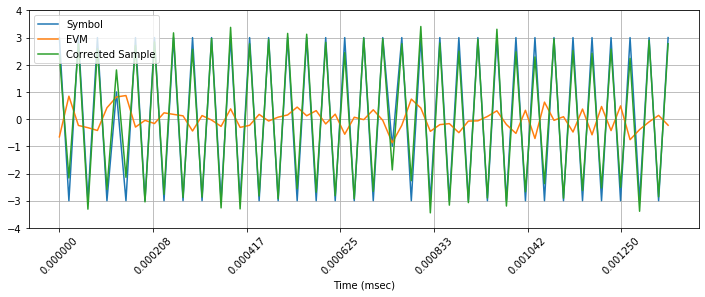

In [10]:
index = 17475
tmp = filtered_data[index-640:index+640]

demod = FSK4Demod(sample_rate, symbol_rate)
t = [demod(x) for x in tmp]
plot_to_notebook([x for x in t[640:] if x is not None], sample_rate, ["Symbol", "EVM", "Corrected Sample"])

## Clock Recovery

As the demodulator samples the incoming signal, it needs to sample the
signal at the peak of the impulse response.  We also need to track the
symbol clock drift between the transmitter and receiver.

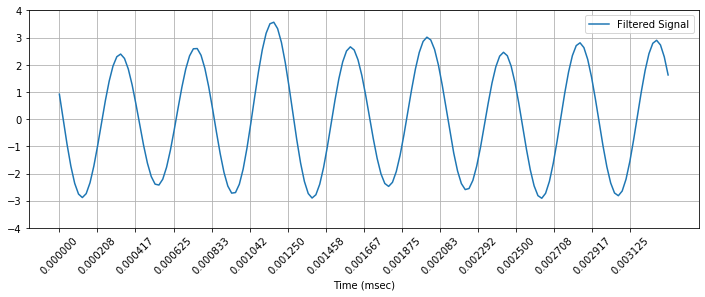

In [33]:
index = 17275
plot_to_notebook(filtered_data[index:index+160], sample_rate, ['Filtered Signal'])

How do we determine the peak of the impulse response?  While it
might seam easy here, where we are looking at the preamble, which
is a continuous sinusoid, it gets less easy to do with a 4-FSK
signal, which is transitioning across 4 levels.

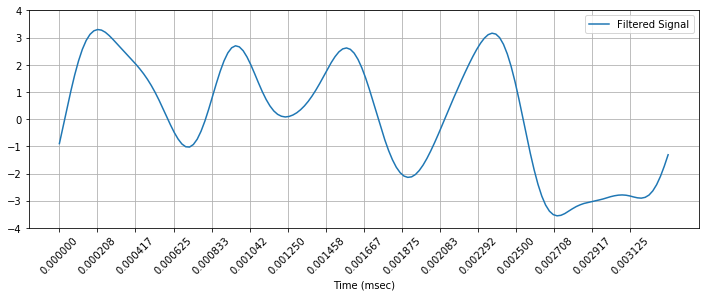

In [34]:
index = 27275
plot_to_notebook(filtered_data[index:index+160], sample_rate, ['Filtered Signal'])

The way we adjust the clock is typically by iteratively approaching
an ideal value.  By making large adjustments when the error is large
and smaller adjustments as the timing converges on the ideal value.

In our case, we need to pick which of the 10 samples per symbol is
the best.  And we need to adjust that point as the ideal spot changes
over time.

Let's review this problem by looking in detail at the samples we
receive from the filter.  Our RRC filter's job is to concentrate the
symbol energy, the impulse, at the ideal center of the symbol.

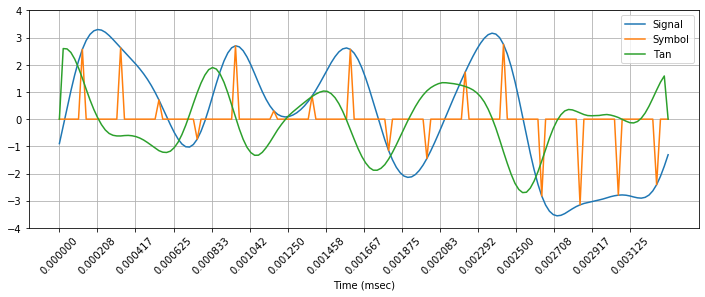

In [37]:
test_data = np.array([-1298, -627, 64, 749, 1406, 2004, 2530, 2971, 3321, 3579, 3742, 3817, 3811, 3732, 3586, 3385, 3143, 2872, 2584, 2290, 2002, 1728, 1475, 1242, 1034, 845, 668, 498, 330, 161, -10, -174, -325, -453, -547, -596, -597, -535, -412, -237, -17, 230, 491, 748, 983, 1179, 1332, 1432, 1477, 1476, 1430, 1354, 1254, 1138, 1016, 898, 790, 694, 614, 556, 524, 520, 548, 615, 725, 876, 1069, 1305, 1574, 1861, 2152, 2426, 2666, 2850, 2958, 2978, 2897, 2717, 2440, 2078, 1646, 1166, 660, 151, -337, -786, -1174, -1493, -1736, -1894, -1973, -1976, -1916, -1797, -1643, -1457, -1258, -1054, -853, -664, -479, -297, -114, 79, 291, 526, 792, 1088, 1407, 1734, 2053, 2336, 2558, 2696, 2724, 2628, 2402, 2047, 1571, 1001, 368, -297, -957, -1578, -2129, -2585, -2925, -3151, -3267, -3283, -3221, -3100, -2945, -2775, -2610, -2460, -2338, -2242, -2175, -2128, -2106, -2100, -2112, -2149, -2208, -2292, -2404, -2544, -2707, -2886, -3066, -3224, -3342, -3400, -3382, -3269, -3063, -2757, -2372, -1926])
test_data = filtered_data[index:index+160]

sample_points = [x if i % 10 == 6 else 0 for i,x in enumerate(test_data)]
tan = np.concatenate([[0], ((test_data[:-2] - test_data[2:]) / -0.5), [0]])
        
plot_to_notebook([x for x in zip(test_data, sample_points, tan)], sample_rate, ['Signal', 'Symbol', 'Tan'], lines = ['-', '-', '-'])

Let's look at this closely. It may be hard to interpret here, but we are
looking at the signal, the ideal symbol sample points, and the tangent
(scaled) of each sample.  Note also that the tangent is 0 at the crest
of each sinusoid.

While not all of the symbols are near the crest, a few of them are. During
the preamble, all of them are.  Beyond that, the others are on more gentle
slopes of the tangent, and their relative values centered around 0.

The direction the tangent forces the tracking point changes as the sample
crosses the 0 threshold value.

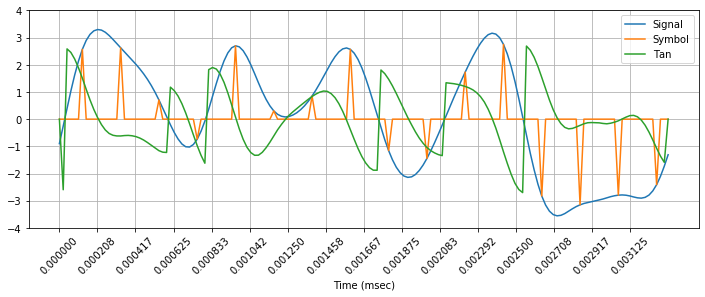

In [38]:
tan = np.array([x if s > 0 else -x for x,s in zip(tan, test_data)])
plot_to_notebook([x for x in zip(test_data , sample_points, tan)], sample_rate, ['Signal', 'Symbol', 'Tan'], lines = ['-', '-', '-'])

What this now shows is the direction and magnitude that, if you
were to sample at that time, to adjust the sample time. 

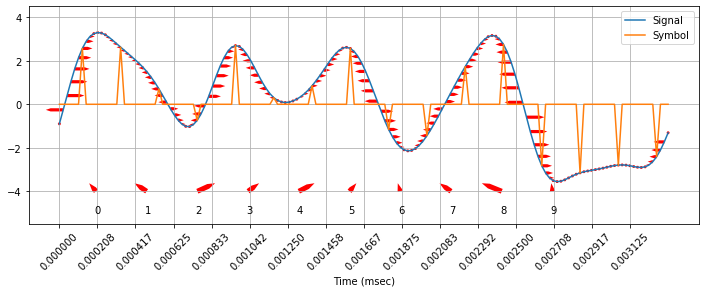

In [47]:
def plot_time(signal, sample, tan, sample_rate, legend):

    duration = len(signal) / sample_rate
    t = np.linspace(0, duration, len(signal), endpoint=True)
    plt.figure()
    plt.rcParams['figure.figsize'] = [12, 4]
    ax = plt.subplot(1, 1, 1)
    plt.xlabel('Time (msec)')
    plt.locator_params(axis='y', nbins=8)
    plt.grid()
    plt.ylim(-5.5,4.5)
    plt.xticks(np.arange(0, duration, 1.0/4800.0), rotation=45)
    plt.plot(t, [x for x in zip(signal, sample)])
    plt.legend(legend)
    q = ax.quiver(t, signal, np.array(tan), 0, linewidth=[0.01], color = 'r', headwidth=1.0, headlength=1.5, scale = 100)
    tans = [np.sum(tan[x::10]) for x in range(10)]
    x = np.linspace(0.0002, duration * 0.75 + 0.0002, len(tans), endpoint=True)
    y = np.zeros(len(tans)) - 4
    ax.quiver(x, y, np.array(tans) * 0.5, 1.2, linewidth=[0.01], color = 'r', headwidth=1.0, headlength=1.5, scale = 100)
    for i, t, p in zip(range(len(tans)), tans, x):
        ax.annotate('{}'.format(i), (p - .00001, -5))
    

plot_time(test_data, sample_points, tan, sample_rate, ['Signal', 'Symbol'])

Now, the sum of all these vectors points toward the spot where the
RRC filter has concentated the symbol energy.  And, on average, this
is where the symbol should be sampled.  Also note that the magnitude
of the vectors are greatest where the sample time is wrong. This
causes the clock to sync quickly, even with very low gain.  And this
low gain is necessary to limit the jitter from the sample points
that are on a slope.

The vectors on the bottom show the sum of tangents for each sample point.
If you look at the code, we chose sample 6 as our sample point.  And in
fact this is roughly the point towards which all the other vectors point.
This is true even though many of the ideal sample points do not have 0
tangents themselves.  Because of the stochastic nature of the symbols and
the AWGN, there will be small perterbations either direction but these
always approach the ideal.

It may help to see what this looks like when sampling the preamble.

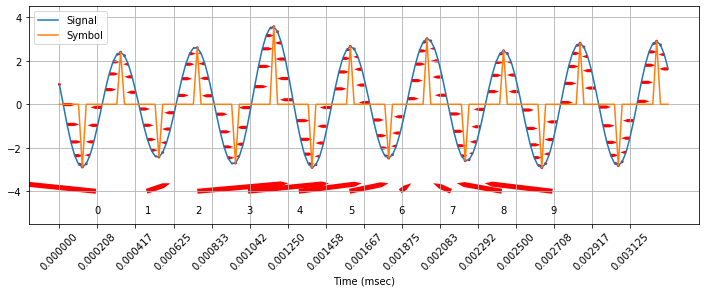

In [48]:
index = 17275
preamble_data = filtered_data[index:index+160]
preamble_points = [x if i % 10 == 6 else 0 for i,x in enumerate(preamble_data)]
ptan = np.concatenate([[0], (preamble_data[:-1] - preamble_data[1:]) / -0.5, [0]])
ptan = np.array([x if s > 0 else -x for x,s in zip(ptan, preamble_data)])
plot_time(preamble_data, preamble_points, ptan, sample_rate, ['Signal', 'Symbol'])

Here you can see that when sampling at any point other than the
ideal sample point, the vectors are pointing in the direction and
magnitude of the best sample point.  This holds true in the general
case as well when averaged over all symbols.  The timing routine
is nudged in the direction of the optimal sample point.  The preamble
provides very strong forcing of the sample point towards the ideal.

To compute the vector, we just need 3 sample -- the sample point
and the sample before and after it.  In our implementation, we
return the symbol one sample after the symbol sample time.  It
may possible to change the implementation to return the symbol at
the symbol sample time but this has not yet been investigated.

Below is the code for the phase estimator.  This works best when
done after deviation and frequency adjustments (level offset and
magnitude adjustments) have been made.

In [17]:
class PhaseEstimator(object):
    """Estimate the phase of a sample by estimating the
    tangent of the sample point.  This is done by computing
    the magnitude difference of the previous and following
    samples.  We do not correct for 0-crossing errors because
    these errors have not affected the performance of clock
    recovery."""

    def __init__(self, sample_rate, symbol_rate):
        
        self.dx = 2 * symbol_rate / sample_rate
        self.samples = np.zeros(3)
        self.index = 0
        self.min_y = np.zeros(32)
        self.max_y = np.zeros(32)
        self.min_i = 0
        self.max_i = 0

    def _estimate(self):
        
        self.min_y[self.min_i] = np.min(self.samples)
        self.max_y[self.max_i] = np.max(self.samples)
        self.min_i += 1
        if self.min_i == len(self.min_y):
            self.min_i = 0
        self.max_i += 1
        if self.max_i == len(self.max_y):
            self.max_i = 0

        y_scale = (np.max(self.max_y) - np.min(self.min_y)) / 2.0
        dy = (self.samples[2] - self.samples[0]) / y_scale
        
        ratio = dy/self.dx
        ratio = min(5.0, ratio)
        ratio = max(-5.0, ratio)
        
        return ratio

    def estimate(self, samples):
        
        self.samples = samples
        return self._estimate()
    
    def __call__(self, sample):
        """This performs a rolling estimate of the phase."""
        
        if self.index < 3:
            self.samples[self.index] = sample
            self.index += 1
            return 0
        
        self.samples[0] = self.samples[1]
        self.samples[1] = self.samples[2]
        self.samples[2] = sample
        
        return self._estimate()

This code will estimate the phase of the signal.  It can do this
in batch mode or one continuous mode.  Our demodulator will use
batch mode, but continuous mode is good for graphing data.

### Deviation Error

One of the things we need to measure and account for is deviation
error.  The symbols are expected to swing between +3 and -3.  The
M17 spec defines these as +2400Hz and -2400Hz frequency deviation.
If the deviation is lower, the symbols will not be decoded properly.
Deviation error correction is essentially an automatic gain control.
A typical 4-FSK signal can swing rather far beyond the 2400Hz.  If
you go back and look at the previous signals, its maximum deviation
is around 3000Hz.

We want to measure deviation at the symbol peaks (+3/-3) and ignore
the +1/-1 symbols.  We then just have a running collection of peak
values that are averaged.  We have a slow decay, so that if a sample
has not been added to the pool in a while, the oldest sample is
replaced.

The measured deviation is then used to calculate the error, and then
each sample is corrected by multiplying by its reciprocal.

Because our clock sync is independent of signal magnitude, the deviation
correction and clock sync can converge together.

In [18]:
class DeviationError(object):
    
    def __init__(self, samples = 10):
        
        self.mins = np.zeros(10)
        self.maxs = np.zeros(10)
        self.min_i = 0          # index
        self.min_r = False      # rolled
        self.min_c = 0          # count since last add
        self.max_i = 0          # index
        self.max_r = False      # rolled
        self.max_c = 0          # count since last add
        
        self.min_estimate = 0.0
        self.max_estimate = 0.0
    
    def __call__(self, sample):
        
        if sample > 0:
            if sample > self.max_estimate * 0.67 or self.max_c == 5:
                self.max_c = 0
                self.maxs[self.max_i] = sample
                self.max_i += 1
                if self.max_i == len(self.maxs):
                    self.max_r = True
                    self.max_i = 0
                if self.max_r:
                    self.max_estimate = np.sum(self.maxs) / len(self.maxs)
                else:
                    self.max_estimate = np.sum(self.maxs[:self.max_i]) / self.max_i
            else:
                self.max_c += 1
        elif sample < 0:
            if sample < self.min_estimate * 0.67 or self.min_c == 5:
                self.min_c = 0
                self.mins[self.min_i] = sample
                self.min_i += 1
                if self.min_i == len(self.mins):
                    self.min_r = True
                    self.min_i = 0
                if self.min_r:
                    self.min_estimate = np.sum(self.mins) / len(self.mins)
                else:
                    self.min_estimate = np.sum(self.mins[:self.min_i]) / self.min_i
            else:
                self.min_c += 1
        
        deviation = self.max_estimate - self.min_estimate
        deviation_error = 6.0 / deviation if deviation != 0 else 100.0
        return deviation_error

### Frequency Error

Frequency error correction is necessary because, in SDRs or analog
systems where demodulator is DC coupled to the receiver, a frequency
offset will impart a DC bias to the symbol, causing all of the
values to be either too high or too low.

The frequency error is measured by decoding symbols and averaging
the error vector magnitude (EVM) over time.  This is then subtracted
from the signal.  This frequency error can also be used to fine-tune
the receiver.

Because frequency error calculations require accurate timing and
deviation correction, the frequency error can be wildly inaccurate
when adjusting these parameters.  The frequency error needs to be
adequately damped to prevent wild swings.  For this we use a two-pole
Butterworth filter.

*It is worth exploring whether an FIR filter would work better here.*

In [19]:
from scipy.signal import butter, sosfilt, sosfilt_zi
    
class SymbolEvm(object):
    
    def __init__(self, nyquist = .1, erasure_limit = None):
        
        self.evm_sos = butter(2, [nyquist], 'low', output = 'sos')
        self.evm_zi = sosfilt_zi(self.evm_sos)
        _, self.evm_zi = sosfilt(self.evm_sos, np.zeros(int(1/nyquist)), zi = self.evm_zi)
        self.erasure_limit = erasure_limit
        self.evm = 0.0
    
    def filtered_evm(self):
        
        return self.evm
    
    def decode(self, sample):
        """Decode a normalized sample into a symbol.  Symbols
        are decoded into +3, +1, -1, -3.  If an erasure limit
        is set, symbols outside this limit are 'erased' and
        returned as 0."""
        
        if (sample > 2):
            symbol = 3
            evm = sample - 3
        elif (sample > 0):
            symbol = 1
            evm = sample - 1
        elif (sample >= -2):
            symbol = -1
            evm = sample + 1
        else:
            symbol = -3
            evm = sample + 3
            
        if (self.erasure_limit is not None and abs(evm) > self.erasure_limit):
            symbol = 0
        
        result, self.evm_zi = sosfilt(self.evm_sos, [evm], zi = self.evm_zi)
        self.evm = result[0]
        
        return symbol, evm

## Demodulator

It might be helpful to refer back to the [demodulator diagram](#4-FSK-Demodulator-Diagram)
at the start of this section to see the overall picture.

The algorithm we will follow will be:

 1. Receive sample and increment the sample counter.
 1. If the sample counter has not overflowed.
    1. Save the sample as $sample_0$ and return.
 1. When sample counter overflows:
    1. Save the sample as $sample_1$
    1. Set a "sample flag"
    1. Roll the sample counter (subtract 1.0)
 1. If the "sample flag" has been set:
    1. Reset the sample flag
    1. Save the sample as $sample_2$
    1. Update deviation estimate and normalize sample magnitude
    1. Normalize the sample DC offset
    1. Capture symbol and EVM
    1. Use EVM to update DC offset estimate
    1. Return normalized sample, phase estimate as $\tan(\theta)$, symbol, EVM, deviation and frequency offset estimates.

This will consume *samples per symbol* samples (more or less) and output
a single sample value -- the one at current best estimate of the proper
sample point.

The demodulator returns both the normalized sample and the symbol because
the symbol returned is a hard decision, and returning the sample allows
using a soft decision or LLR symbol decoder.  $sample = symbol + evm$, so
there is some redundancy in the data returned.

Tuning of the hyperparameters has not been done.  The optimum gain value
has not been fully explored.  Higher gain results in timing jitter, while
low gain results in slower symbol clock synchronization.

In [20]:
class Demod4FSK(object):
    
    def __init__(self, sample_rate, symbol_rate, gain = 0.04):
        """
        Initialize the demodulator.
        
        @param sample_rate is the sample rate in Hz
        @param symbol_rate is the symbol rate in Hz
        @param gain is the phase adjustment gain. 
        """
        
        self.sample_rate = sample_rate
        self.symbol_rate = symbol_rate
        self.deviation_error = DeviationError()
        self.symbol_evm = SymbolEvm()
        self.phase = PhaseEstimator(self.sample_rate, self.symbol_rate)
        self.gain = gain * self.symbol_rate / self.sample_rate
        
        self.samples = np.zeros(3)
        
        self.t = 0.0
        self.dt = self.symbol_rate / self.sample_rate
        self.ideal_dt = self.dt
        self.sample_now = False
        
        self.e_deviation = 1.0
        self.e_frequency = 0.0
    
    def demod(self):
        
        self.e_deviation = self.deviation_error(self.samples[1])
        
        self.samples *= self.e_deviation
        self.samples -= self.e_frequency

        phase = self.phase.estimate(self.samples)
        if self.samples[1] < 0:
            phase *= -1
        
        self.dt = self.ideal_dt - phase * self.gain
        self.t += self.dt
        
        symbol, evm = self.symbol_evm.decode(self.samples[1])
        self.e_frequency = self.symbol_evm.filtered_evm()

        return self.samples[1], phase, symbol, evm
        
    def __call__(self, sample):
        """Process the sample.  If a symbol is ready, return a tuple
        containing the sample used, the estimated phase, the decoded
        symbol, the EVM, the deviation error and the frequency error
        (sample, phase, symbol, evm, ed, ef), otherwise None.
        """
        
        if self.sample_now:
            self.samples[2] = sample
            self.sample_now = False
            return (*self.demod(), self.e_deviation, self.e_frequency)
            
        self.t += self.dt
        if self.t < 1.0:
            self.samples[0] = sample
        else:
            self.t -= 1.0
            self.samples[1] = sample
            self.sample_now = True
        
        return [None] * 6

Let's now take a look at the output of the demodulator.

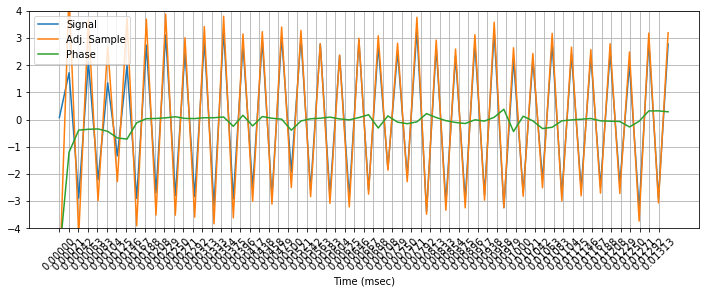

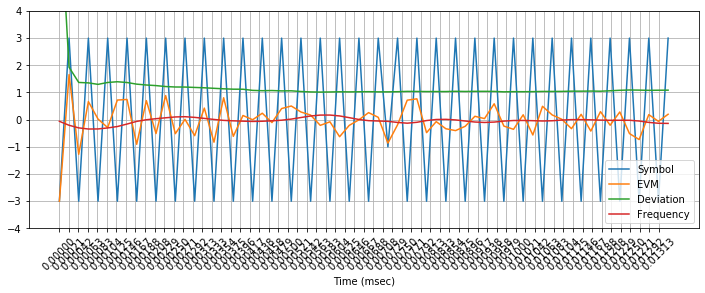

In [58]:
index = 17475
tmp = filtered_data[index:index+640]

demod = Demod4FSK(sample_rate, symbol_rate, .04)
syms = [(x, *demod(x)) for x in tmp]

plot_to_notebook([x[:3] for x in syms if x[1] is not None], symbol_rate,
                 ["Signal", "Adj. Sample", "Phase"], lines = ['-','.','-'])

plot_to_notebook([x[3:] for x in syms if x[1] is not None], symbol_rate,
                 ["Symbol", "EVM", "Deviation","Frequency"], lines = ['-','.','-','-'])

Here you can see the clock recovery converge on the symbols with the
lowest EVM very quickly.  Note that only one sample is returned for
symbol.  The values used so far for tuning the clock recovery are just
placeholders.

Work still needs to be done to determine the optimal values.

## Demodulation Animation

We are now going to demodulate the entire filtered data and then animate
the demodulated data so that various aspects of the demodulator behavior
can be inspected closely.

In [59]:
demod = Demod4FSK(sample_rate, symbol_rate, .04)
d = [(x, *demod(x)) for x in filtered_data]
# output is (raw sample, adj. sample, phase, symbol, evm, deviation error, frequency error)

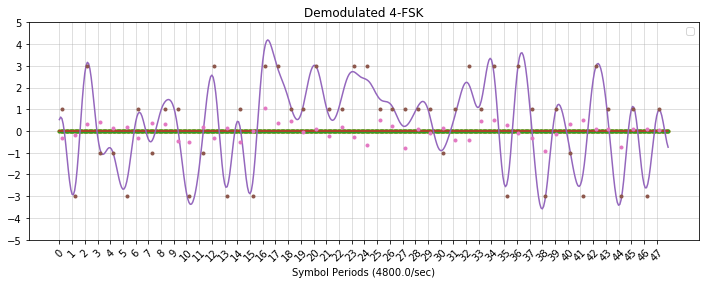

In [60]:
from matplotlib import animation, rc
from IPython.display import HTML

class EvmAnimation(object):
    
    def __init__(self, demod):

        self.demod = demod
        self.sample_rate = 48000.0
        self.symbol_rate = 4800.0
        self.symbols = 48.0
        self.samples_per_frame = int(self.symbols * self.sample_rate / self.symbol_rate)
        self.duration = self.samples_per_frame / self.sample_rate # 48 symbols, 1/4 of a frame
        self.t = np.linspace(0, self.duration, self.samples_per_frame, endpoint=False)
        self.fig, self.ax = plt.subplots(1, sharex=True)
        plt.xlabel('Symbol Periods ({}/sec)'.format(self.symbol_rate))
        plt.title("Demodulated 4-FSK")
        plt.rcParams["animation.html"] = "jshtml"
        plt.rcParams["animation.embed_limit"] = 20.0
        plt.rcParams['figure.figsize'] = [9, 4]

        self.ax.grid(which='major', alpha=0.5)
        plt.xticks(np.arange(0, self.duration, self.duration / self.symbols), rotation=45)
        self.ax.set_xticklabels(np.arange(0,self.samples_per_frame))
        self.ax.set_ylim(-5, 5)
        plt.locator_params(axis='y', nbins=int(self.symbols / 4))
        plt.legend(['Sample', 'Symbol', 'EVM', 'Filtered EVM'])

    def init(self):
        self.fsk = np.zeros(self.samples_per_frame)
        self.sample_line, = self.ax.plot(self.t, self.fsk, '-', label='Signal')
        self.sample_line.set_data(self.t, self.fsk)
        self.symbol_line, = self.ax.plot(self.t, self.fsk, '.', label='Symbol')
        self.symbol_line.set_data(self.t, self.fsk)
        self.evm_line, = self.ax.plot(self.t, self.fsk, '.', label='EVM')
        self.evm_line.set_data(self.t, self.fsk)
        self.filtered_line, = self.ax.plot(self.t, self.fsk, '-', label='Dev')
        self.filtered_line.set_data(self.t, self.fsk)
        return (self.sample_line,self.symbol_line,self.evm_line,self.filtered_line,)

    def animate(self, i):
        if i == 0:
            self.start = 0
        else:
            self.start += self.samples_per_frame
        block = self.demod[self.start:self.start+self.samples_per_frame]
        self.sample_line.set_data(self.t, [x[0] for x in block])
        self.symbol_line.set_data(self.t, [x[3] for x in block])
        self.evm_line.set_data(self.t, [x[4] for x in block])
        self.filtered_line.set_data(self.t, [x[5] for x in block])
        return (self.sample_line,self.symbol_line,self.evm_line,self.filtered_line,)

a = EvmAnimation(d)
# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(
    a.fig, a.animate, init_func=a.init,
    frames=300, interval=1000/24, blit=True)

HTML(anim.to_jshtml())
# metadata = dict(title='M17', artist='Mobilinkd LLC', comment='M17 Baseband Demodulation')
# anim.save('m17-demod.webm', writer='ffmpeg', fps=25, metadata=metadata, codec='libvpx-vp9', extra_args=["-crf", "10", "-vf", "scale=640:-1"])

Use the animation to explore the signal.  Find the preamble and see
the clock recovery occur. Look at where the symbols are in relation
to the corrected samples.

Note that we are using a signal that is near the lower end of usable
SNR (6dB).

### Timing Lock

It is often advantageous to know if the clock has been recovered. There
is no need to attempt to demodulate noise.  It can also be used to drive
a data carrier detect (DCD) indicator.

A simple timing lock can be built that looks at the RMS of the EVM.

The lock function returns both a Boolean lock indicator and the RMS value.

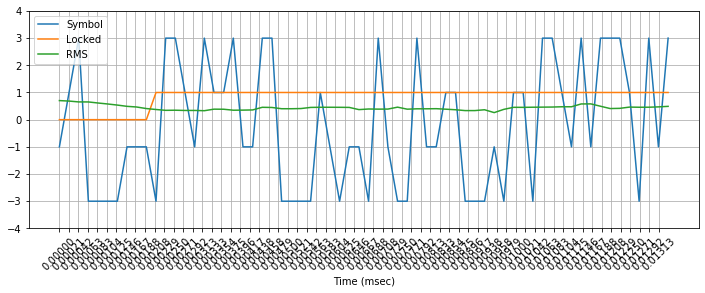

In [81]:
class SignalLock(object):
    
    def __init__(self, lock_level, unlock_level = None, size = 10):
        
        self.lock_level = lock_level
        self.unlock_level = lock_level if unlock_level is None else unlock_level
        self.size = size
        self.samples = np.zeros(size) + 0.5
        self.index = 0
        self.locked = False
    
    def __call__(self, evm):
        self.samples[self.index] = evm * evm
        self.index += 1
        if self.index == self.size:
            self.index = 0
        
        rms = np.sqrt(np.sum(self.samples) / self.size)
        if not self.locked:
            if rms < self.lock_level:
                self.locked = True
        else:
            if rms > self.unlock_level:
                self.locked = False
        
        return self.locked, rms

evmLock = SignalLock(0.4, unlock_level = 0.7)
locked = [(x[3], *evmLock(x[4])) for x in d[27171:27171+640] if x[3] is not None]
plot_to_notebook(locked, symbol_rate, ["Symbol", "Locked", "RMS"])

It may be possible to use the RMS of EVM as a reasonable indication of SNR.

## Symbol Framing

We now have the demodulator complete.  What remains is assembling the
demodulatoed symbols into frames, and then decoding those frames.

To find the start of a frame, we need to detect the sync word.  The
frame should immediately follow.  Each frame has a defined number of
symbols followed by another sync word.

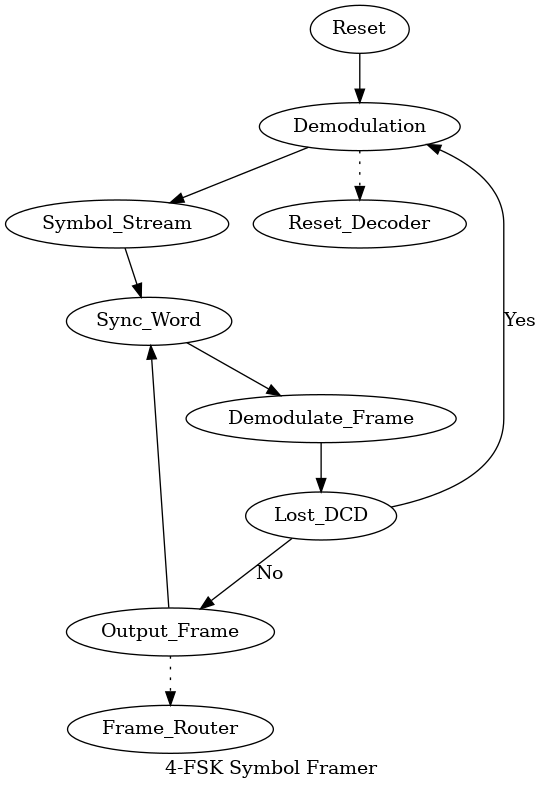

In [82]:
g3 = """digraph top {
   label = "4-FSK Symbol Framer";
   
   Reset -> Demodulation;
   Demodulation -> Symbol_Stream;
   Demodulation -> Reset_Decoder [style=dotted];
   Symbol_Stream -> Sync_Word;
   Sync_Word -> Demodulate_Frame;
   Demodulate_Frame -> Lost_DCD;
   Lost_DCD -> Demodulation  [label="Yes"];
   Lost_DCD -> Output_Frame [label="No"];
   Output_Frame -> Sync_Word;
   Output_Frame -> Frame_Router [style=dotted];
}"""

draw(g3)

### Symbol Mapping

We now need to map the symbols to bits.  There are two ways to do this,
soft decision and hard decision.  A hard decision takes the nearest
symbol regardless of EVM and determines the bits using a direct mapping.
A soft decision takes into account the adjusted sample value and maps that
to an LLR (log-likelyhood ratio) that is -max for 0 and +max for 1,
0 for an erasure, and values between the two extremes as log likelyhood
ratios (likely 0 vs likely 1).

A soft decision can be passed down to a soft-decision Viterbi decoder.

To simplify the processing, we are going to implement hard-decision
symbol mapping.  We will still use a soft-decision Viterbi decoder because
the scikit.commpy Viterbi decoder cannot handle the erasures from the
puncture matrix in the hard decoder.

In [27]:
def from_4fsk(symbol):
    """Convert a 4-FSK symbol to a pair of bits."""
    if symbol == 1: return 0
    elif symbol == 3: return 1
    elif symbol == -1: return 2
    elif symbol == -3: return 3
    else: raise ValueError("not a 4-FSK symbol")

### Sync Word Detection

Sync words offer the ability to do channel estimation by matching the
expected baseband impulse to a reference impulse of the sync word,
allowing estimates of timing and phase offsets.  This can be used, for
example, to tune matching filters or adjust the timing of sampling.

Fine tuned sampling and accurate timing can allow for improved
performance with reduced sample rates by ensuring the ADCs are tuned
to sample the signal at the peak of the impulse or to adjust the timing
of decimators to reduce computational workload.

We are going with a trivial implementation, just detecting the bit sequence
as a start of frame indicator.

The sync word used by M17 is 0x3243.  This is, in binary, 0011 0010 0100 0011.
This can be further expressed as the symbol sequence +1, -3, +1, -1, +3, +1, +1, -3.

In [85]:
class Synchronizer(object):
    
    def __init__(self, word = 0x3243, bit_errors = 1):
        
        self.expected = word
        self.buffer = 0
        self.bit_errors = bit_errors
        
    @staticmethod
    def popcount(value):
        
        count = 0
        for i in range(16):
            if value & (1 << i):
                count += 1
        return count
    
    def __call__(self, bits):
        """Add one symbol (2 bits) of data to the synchronizer.
        Returns true when a sync word has been detected."""
        
        self.buffer = ((self.buffer << 2) | bits) & 0xFFFF
        tmp = self.buffer ^ self.expected
        return self.popcount(tmp) <= self.bit_errors
    
    def reset(self):
        self.buffer = 0

sync = Synchronizer(bit_errors = 1)
print([sync(x) for x in [0,3,0,2,1,0,0,3]])
sync.reset()
print([sync(x) for x in [0,3,0,2,1,1,1,3]]) # Two bad bits.

[False, False, False, False, False, False, False, True]
[False, False, False, False, False, False, False, False]


1917


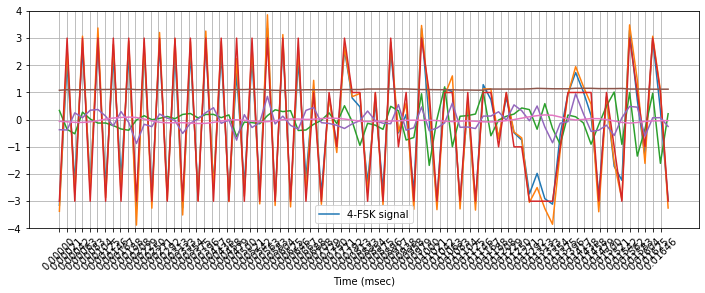

In [86]:
# Find the first sync word in our demodulated data
e = [s for s in d if s[1] is not None]
sync = Synchronizer(bit_errors = 0)
for i, s in enumerate(e):
    bits = from_4fsk(s[3])
    if sync(bits):
        break

first_frame_index = i
print(first_frame_index)

plot_to_notebook(e[first_frame_index - 40:first_frame_index+40], symbol_rate)

### Frame Generator

The frame generator is responsible for gathering *frame size* bits
into a frame for decoding.  This should start as soon as the sync
word is detected and returns true.  Essentially, the demodulator
should switch between feeding the sync word detector and the frame
generator until either loss of signal or the last frame is received
(high bit on frame number is set).

In [87]:
class Framer(object):
    
    def __init__(self, size = 368):
        
        self.size = size
        self.reset()
        
    def reset(self):
        
        self.data = np.zeros(self.size, dtype=np.int8)
        self.index = 0
    
    def __call__(self, bit):
        
        self.data[self.index] = bit
        self.index += 1
        if self.index == self.size:
            self.index = 0
        
        return self.data if self.index == 0 else None

In [124]:
framer = Framer()
sync = Synchronizer(bit_errors = 0)
syncronizing = True
frames = None
frame_count = 0
for s in e:
    bits = from_4fsk(s[3]) 
    if syncronizing:
        if sync(bits):
            syncronizing = False
    else:
        framer(bits >> 1)
        data = framer(bits & 1)
        if data is not None:
            frame_count += 1
            if frames is None:
                frames = np.array([data])
            else:
                frames = np.append(frames, [data], axis=0)
            syncronizing = True
            sync = Synchronizer(bit_errors = 3)

print(len(frames), framer.index)
print(frame_count, frame_count / 25, "seconds of data")

214 360
214 8.56 seconds of data


Now that we have all of the frames decoded, we can check the bit
error rate (BER) against a reference data set. The file `m17.bin`
is written out at the same time as the baseband WAV file read
in at the beginning of this notebook, and contains the bitstream
encoded as raw bytes.

https://scipy-cookbook.readthedocs.io/items/CommTheory.html

In [90]:
reference = open('m17.bin', 'rb').read()

def byte_to_symbols(data):
    """Convert byte to big endian symbol stream."""
    result = np.zeros(4, dtype=np.uint8)
    for i in range(4):
        result[i] = (data & 0xC0) >> 6
        data = data << 2
    return result

def binary_to_symbols(bits):
    """Return an array of binary symbols (bit pairs) to 4-FSK symbols."""
    return np.array([to_4fsk(x) for x in bits], dtype=np.int8)

def bytes_to_symbols(data):
    return np.concatenate(np.array([byte_to_symbols(x) for x in data]))

reference_symbols = bytes_to_symbols(reference)

reference_framer = Framer()
reference_sync = Synchronizer(bit_errors = 0)
syncronizing = True
reference_frames = None
reference_frame_count = 0

for sym in reference_symbols:
    if syncronizing:
        if reference_sync(sym):
            syncronizing = False
    else:
        reference_framer(sym >> 1)
        data = reference_framer(sym & 1)
        if data is not None:
            reference_frame_count += 1
            if reference_frames is None:
                reference_frames = np.array([data])
            else:
                reference_frames = np.append(reference_frames, [data], axis=0)
            syncronizing = True
            reference_sync = Synchronizer(bit_errors = 3)

print(len(reference_frames))
print(reference_frame_count, reference_frame_count / 25, "seconds of data")

bits = 0
errors = 0
for i, f1, f2 in zip(range(len(frames)), frames, reference_frames[:-1]):
    bits += len(f1)
    errors += np.sum(np.bitwise_xor(f1,f2))

print("BER =", errors/bits)

215
215 8.6 seconds of data
BER = 0.005955404307192198


The measured BER appears to be what is expected with 6dB SNR based on this reference:
https://core.ac.uk/download/pdf/235049678.pdf

## Stream Decoder

Now that we have our frames, we need to start decoding the stream of
data that is being received.  We need to parse the link setup frame.
If that fails, we need to parse the LICH from the next set of frames
until we have a valid link setup frame.  We can then start decoding
the audio frames.

*Decoding of the LICH is yet to be completed.*

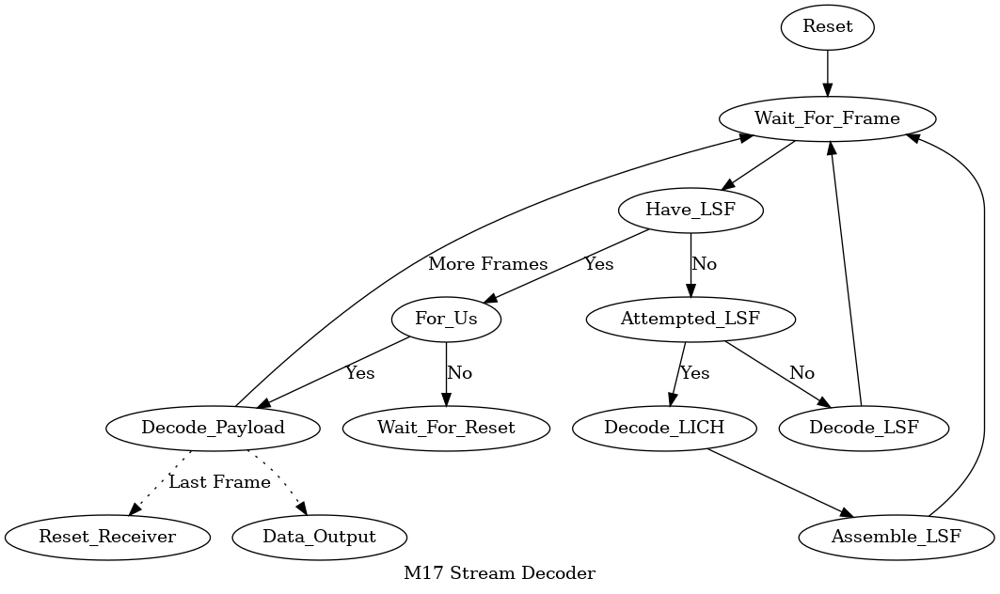

In [123]:
g3 = """digraph top {
    
   label = "M17 Stream Decoder";

   Reset -> Wait_For_Frame;
   Wait_For_Frame -> Have_LSF;
   Have_LSF -> For_Us [label="Yes"];
   Have_LSF -> Attempted_LSF [label="No"];
   For_Us -> Decode_Payload [label="Yes"];
   For_Us -> Wait_For_Reset [label="No"];
   Attempted_LSF -> Decode_LSF [label="No"];
   Decode_LSF -> Wait_For_Frame;
   Attempted_LSF -> Decode_LICH [label="Yes"];
   Decode_LICH -> Assemble_LSF;
   Assemble_LSF -> Wait_For_Frame;
   Decode_Payload -> Wait_For_Frame [label="More Frames"];
   Decode_Payload -> Reset_Receiver [label="Last Frame" style=dotted];
   Decode_Payload -> Data_Output [style=dotted];

}"""

draw(g3)

### Link Setup Frame Decoder

The first frame we need to decode is the *link setup frame*.  This
frame contains the sender and recipient identifiers, along with
information about the stream contents (audio, data, both).

To do this we need to de-randomize, de-interleave and decode the
bitstream, then we need to parse the data and decode the sender
and receiver call signs.  One of the key outputs of the LSF decoder
is the frame type field.

We use the same interleaver that was used for the modulator.

In [125]:
class PolynomialInterleaver(object):
    """Polynomial bit interleaver.  Default to 80.
    
    Valid LTE polynomials can be found here:
    https://github.com/supermihi/lpdec/blob/master/lpdec/codes/interleaver.py#L264
    """
    
    def __init__(self, f1 = 11, f2 = 20, k = 80):
        
        self.f1 = f1
        self.f2 = f2
        self.K = k
    
    def index(self, i):
        
        return ((self.f1 * i) + (self.f2 * i * i)) % self.K
    
    def interleave(self, data):
        result = np.zeros(self.K, dtype = data.dtype)
        for i in range(len(data)):
            result[self.index(i)] = data[i]
        return result
    
    def deinterleave(self, data):
        
        result = np.zeros(len(data), dtype = data.dtype)
        for i in range(len(data)):
            if i == self.K: break
            result[i] = data[self.index(i)]
        return result

    def interlv(self, data):
        return self.interleave(data)

    def deinterlv(self, data):
        return self.deinterleave(data)

Next we will need the Viterbi decoder.

In [113]:
from commpy.channelcoding import Trellis, conv_encode, viterbi_decode
import binascii

def depuncturing(punctured: np.ndarray, punct_vec: np.ndarray, shouldbe: int) -> np.ndarray:
    """
    Applying of the inserting zeros procedure.
    Parameters
    ----------
    punctured : 1D ndarray
        Input punctured message {0,1} bit array.
    punct_vec : 1D ndarray
        Puncturing vector {0,1} bit array.
    shouldbe : int 
        Length of the initial message (before puncturing).
    Returns
    -------
    depunctured : 1D ndarray
        Output vector {0,1} bit array.
    """
    shift = 0
    shift2 = 0
    N = len(punct_vec)
    depunctured = np.zeros((shouldbe,))
    for idx, item in enumerate(depunctured):
        if punct_vec[idx % N] == 1:
            depunctured[idx] = float(punctured[idx - shift2])
        else:
            shift2 = shift2 + 1
    return depunctured


class Decoder(object):
    
    # Puncture matrix for link setup frame.
    P1 = [1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0,
            1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0,
            1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1,
            0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1,
            0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1,
            1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1]

    # Puncture matrix for data frames.
    P2 = [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1,
            0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
            1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1,
            0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]

    
    def __init__(self, polys = [0o31,0o27], size = 4):
        
        self.memory = np.array([size])
        self.trellis = Trellis(self.memory, np.array([[0o31,0o27]]))

    def decode_link_setup(self, frame):
        f = np.array(frame) * 2 -1
        depunctured = depuncturing(f, self.P1, 480)
        return viterbi_decode(depunctured, self.trellis, decoding_type='soft', tb_depth=25)

    def decode_data(self, frame):
        f = np.array(frame) * 2 - 1
        depunctured = depuncturing(f, self.P2, 320)
        return viterbi_decode(depunctured, self.trellis, decoding_type='soft', tb_depth=25)

    
encoded = [1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
decoder = Decoder()
%timeit decoded = decoder.decode_link_setup(encoded)
print(decoded, len(decoded))

def bits_to_bytes(bits):
    x = 0
    for i in bits:
        x <<= 1
        x |= i
    return x

def bitarray_to_bytes(bits):
    
    return bytearray([bits_to_bytes(x) for x in np.split(bits, len(bits)//8)])

lsb = bitarray_to_bytes(decoded[:240])

print(binascii.hexlify(lsb))

212 ms ± 1.64 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
[1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] 240
b'd78a0f000000ffffffffffff000500000000000000000000000000000000'


And then the CRC calculator.

In [110]:
class CRC16(object):
    
    def __init__(self, poly, init):
        self.poly = poly
        self.init = init
        self.mask = 0xFFFF
        self.msb = 0x8000
        self.reset()
    
    def reset(self):
        self.reg = self.init
        for i in range(16):
            bit = self.reg & 0x01
            if bit:
                self.reg ^= self.poly
            self.reg >>= 1
            if bit:
                self.reg |= self.msb
        self.reg &= self.mask

    def crc(self, data):
        for byte in data:
            for i in range(8):
                msb = self.reg & self.msb
                self.reg = ((self.reg << 1) & self.mask) | ((byte >> (7 - i)) & 0x01)
                if msb:
                    self.reg ^= self.poly
         
    def get(self):
        reg = self.reg
        for i in range(16):
            msb = reg & self.msb
            reg = ((reg << 1) & self.mask)
            if msb:
                reg ^= self.poly

        return reg & self.mask
    
         
    def get_bytes(self):
        crc = self.get()
        return bytearray([(crc>>8) & 0xFF, crc & 0xFF])

crc = CRC16(0x5935, 0xFFFF)

We now have all of the components needed to decode the link
setup frame.

In [126]:
import io
import struct

class LinkSetupFrameDecoder(object):

    # Randomization matrix.
    DC = [0xd6, 0xb5, 0xe2, 0x30, 0x82, 0xFF, 0x84, 0x62,
        0xba, 0x4e, 0x96, 0x90, 0xd8, 0x98, 0xdd, 0x5d,
        0x0c, 0xc8, 0x52, 0x43, 0x91, 0x1d, 0xf8, 0x6e,
        0x68, 0x2F, 0x35, 0xda, 0x14, 0xea, 0xcd, 0x76,
        0x19, 0x8d, 0xd5, 0x80, 0xd1, 0x33, 0x87, 0x13,
        0x57, 0x18, 0x2d, 0x29, 0x78, 0xc3]

    @staticmethod
    def to_bit_array(byte_array):
        """Convert byte array to big-endian bit array."""
        return np.concatenate(
            [[int((x & (1<<i)) != 0) for i in range(7,-1,-1)] for x in byte_array])

    @staticmethod
    def bits_to_bytes(bits):
        x = 0
        for i in bits:
            x <<= 1
            x |= i
        return x

    @staticmethod
    def bitarray_to_bytes(bits):
    
        return bytearray([bits_to_bytes(x) for x in np.split(bits, len(bits)//8)])

    def __init__(self, frame):
        
        self.frame = frame
        self.dc = self.to_bit_array(self.DC)
        self.derandomized = np.bitwise_xor(self.frame, self.dc)
        self.interleaver = PolynomialInterleaver(45, 92, 368)
        self.deinterleaved = self.interleaver.deinterleave(self.derandomized)
        self.decoder = Decoder()
        self.decoded = self.decoder.decode_link_setup(self.deinterleaved)
        self.frame_bytes = self.bitarray_to_bytes(self.decoded)
        self.crc = CRC16(0x5935, 0xFFFF)
        self.crc.crc(self.frame_bytes)
        self.checksum = self.crc.get()
        
    
    @staticmethod
    def decode_callsign_base40(encoded_bytes):

        # Convert byte array to integer value.
        i,h = struct.unpack("IH", encoded_bytes)
        encoded = (h << 32) | i

        # Unpack each base-40 digit and map them to the appriate character.
        result = io.StringIO()
        while encoded:
            result.write("xABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789-/."[encoded % 40])
            encoded //= 40;

        return result.getvalue();

    def ok(self):
        return self.checksum == 0
    
    def mycall(self):
        return self.decode_callsign_base40(self.frame_bytes[:6])
        

Let's test the decoder by decoding the first frame that was emitted
by the framer, check the CRC, and output the decoded MYCALL field.

In [114]:
f = frames[0]
lsf = LinkSetupFrameDecoder(f)
print(lsf.ok())
print(binascii.hexlify(lsf.frame_bytes), len(lsf.frame_bytes))
print(lsf.mycall())

True
b'd78a0f000000ffffffffffff0005000000000000000000000000000006a6' 30
WX9O


Decoding the audio frames is fairly straight-forward once we can decode
the LSF.  We read until the end or the high bit on the frame number is
set.

The steps to decode the frames are the same:

 1. De-randomize
 1. De-interleave
 1. Depuncture and Viterbi decode
 1. Convert the bit stream to a byte array
 1. Compute the checksum

In [116]:
import io
import struct

class AudioFrame(object):
    
    def __init__(self, fn, data, crc):
        self.fn = fn
        self.data = data
        self.crc = crc
    
    def ok(self):
        return self.crc == 0

class AudioFrameDecoder(object):

    # Randomization matrix.
    DC = [0xd6, 0xb5, 0xe2, 0x30, 0x82, 0xFF, 0x84, 0x62,
        0xba, 0x4e, 0x96, 0x90, 0xd8, 0x98, 0xdd, 0x5d,
        0x0c, 0xc8, 0x52, 0x43, 0x91, 0x1d, 0xf8, 0x6e,
        0x68, 0x2F, 0x35, 0xda, 0x14, 0xea, 0xcd, 0x76,
        0x19, 0x8d, 0xd5, 0x80, 0xd1, 0x33, 0x87, 0x13,
        0x57, 0x18, 0x2d, 0x29, 0x78, 0xc3]

    @staticmethod
    def to_bit_array(byte_array):
        """Convert byte array to big-endian bit array."""
        return np.concatenate(
            [[int((x & (1<<i)) != 0) for i in range(7,-1,-1)] for x in byte_array])

    @staticmethod
    def bits_to_bytes(bits):
        x = 0
        for i in bits:
            x <<= 1
            x |= i
        return x

    @staticmethod
    def bitarray_to_bytes(bits):
    
        return bytearray([bits_to_bytes(x) for x in np.split(bits, len(bits)//8)])

    def __init__(self):
        
        self.dc = self.to_bit_array(self.DC)
        self.interleaver = PolynomialInterleaver(45, 92, 368)
        self.decoder = Decoder()
        self.crc = CRC16(0x5935, 0xFFFF)

    def decode(self, frame):
        
        derandomized = np.bitwise_xor(frame, self.dc)
        deinterleaved = self.interleaver.deinterleave(derandomized)
        decoded = self.decoder.decode_data(deinterleaved[96:])
        data = self.bitarray_to_bytes(decoded)
        self.crc.reset()
        self.crc.crc(data)
        return AudioFrame(
            (data[0] << 8) | data[1],
            data[2:-2],
            self.crc.get())
        

We can now go through and decode all of the audio frames.

It is worth noting that the CRC can, for the most part, be ignored here.
Just pass the frames, whether they have errors or not, directly to the
Codec2 decoder.

Here we print the count of frames and frames with valid checksums.

In [117]:
compressed_audio = []
decoder = AudioFrameDecoder()
good_frames = 0
for frame in frames[1:]:
    audio = decoder.decode(frame)
    if (audio.ok()): good_frames += 1
    # print(audio.fn)
    # print(binascii.hexlify(audio.data)
    compressed_audio.append(audio.data)

print(len(compressed_audio), good_frames)

213 209


Since we are adding random noise to the input to get an 6dB SNR, the
number of frames with valid checksums will be somewhat random, but
is typically better than 95%.

We can now just pass these to the Codec2 decoder and play the
resulting audio stream.

In [127]:
import pycodec2, struct
import IPython.display as ipd

all = np.concatenate(compressed_audio)
chunks = np.split(all, len(compressed_audio) * 2)
c2 = pycodec2.Codec2(3200)
decoded_audio = concatenate([c2.decode(bytes(bytearray(x))) for x in chunks])

ipd.Audio(decoded_audio, rate=8000)

## LICH Decoder

We will next start on the LICH decoder.  If we miss the first frame
which contains the link setup information, we need to decode the
data from the LICH (link information channel.

For this we will need a Golay(12,24,8) decoder.

In [ ]:
class Golay24(object):
    
    def __init__(self):
        
        b = np.array([1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0], dtype=np.int)
        j = np.array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], dtype=np.int)

        # Construct the base parity matrix.
        B = np.array([np.concatenate([b, [1]])])
        for i in range(10):
            b = np.roll(b, -1)
            B = np.concatenate([B, [np.concatenate([b, [1]])]])
        B = np.concatenate([B, [j]])
        
        # Construct the identity matrix and the two mapping matrices.
        I = np.identity(12, dtype=np.int)
        self.G = np.concatenate([I,B], axis=1)
        self.H = np.concatenate([B,I], axis=1)
        
        # Construct the syndrome-keyed correction lookup table.
        self.LUT = {}
        for errvec in self._make_3bit_errors():
            syn = tuple((self.H @ errvec) % 2)
            self.LUT[syn] = (errvec)

    def encode(self, bits):
        return (bits @ self.G) % 2

    def decode(self, bits):
        syndrome = (self.G @ bits) % 2
        try:
            correction = self.LUT[tuple(syndrome)]
            return ((bits + correction) % 2)[:12], np.sum(correction)
        except KeyError:
            return None, 4
    
    def _make_3bit_errors(self, veclen=24):
        """Return a list of all bitvectors with <= 3 bits as 1's.
        This returns list of lists, each 24 bits long by default.
        """
        errorvecs = []
        # all zeros
        errorvecs.append([0] * veclen)
        # one 1
        for i in range(veclen):
            vec = [0] * veclen
            vec[i] = 1
            errorvecs.append(vec)

        # two 1s
        for i in range(veclen):
            for j in range(i + 1, veclen):
                vec = [0] * veclen
                vec[i] = 1
                vec[j] = 1
                errorvecs.append(vec)

        # three 1s
        for i in range(veclen):
            for j in range(i + 1, veclen):
                for k in range(j + 1, veclen):
                    vec = [0] * veclen
                    vec[i] = 1
                    vec[j] = 1
                    vec[k] = 1
                    errorvecs.append(vec)
        return errorvecs

The rest is still to be completed.